This kernel based on the [this kernerl](https://www.kaggle.com/seriousran/image-pre-processing-for-wild-images)

It introduce image pre-precessing for wild images using CLAHE and AWB

In [1]:
import os
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
!pip install opencv-contrib-python
import cv2
print(os.listdir("../input"))
import matplotlib.pyplot as plt
%matplotlib inline 

     |████████████████████████████████| 34.2 MB 71 kB/s 
['iwildcam-2020-fgvc7']


In [2]:
!ls /kaggle/input/

iwildcam-2020-fgvc7


In [3]:
train_dir = '../input/iwildcam-2020-fgvc7/train'
train_imgs = ['../input/iwildcam-2020-fgvc7/train/{}'.format(i) for i in os.listdir(train_dir)]

In [4]:
num_show = 15
columns = 5

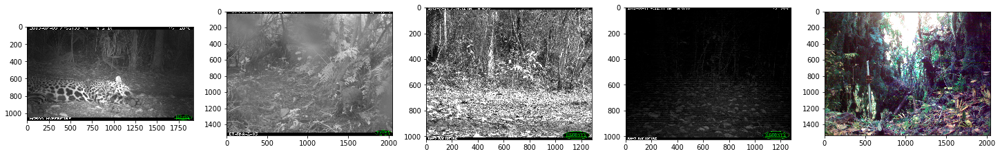

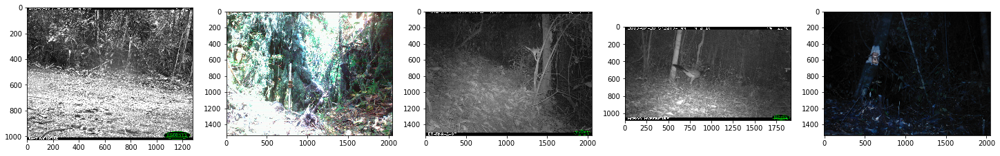

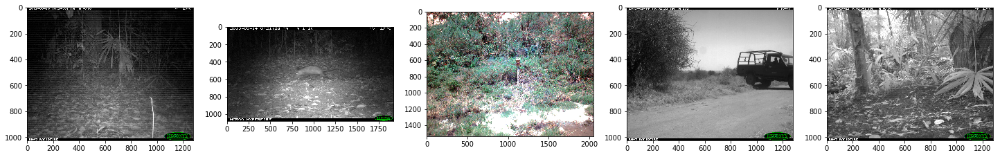

<Figure size 1800x864 with 0 Axes>

In [5]:
plt.figure(figsize=(25,12))
for idx, train_img in enumerate(train_imgs):
    if idx >= num_show:
        break
    
    temp_img = cv2.imread(train_img, cv2.IMREAD_COLOR)
    
    plt.subplot(10 / columns + 1, columns, idx + 1)
    plt.imshow(temp_img)
    if idx % 5 == 4:
        plt.show()
        plt.figure(figsize=(25,12))

# CLAHE(Contrast Limited Adaptive Histogram Equalization)
ref: https://docs.opencv.org/3.1.0/d5/daf/tutorial_py_histogram_equalization.html

In [6]:
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(16, 16))


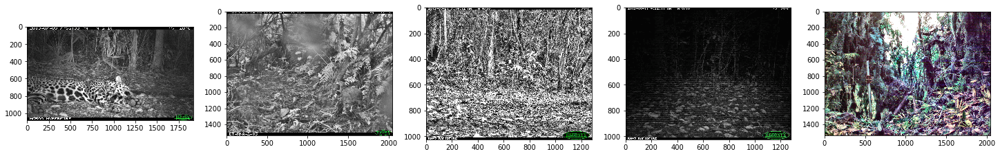

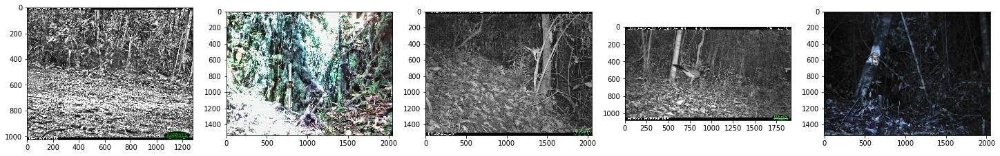

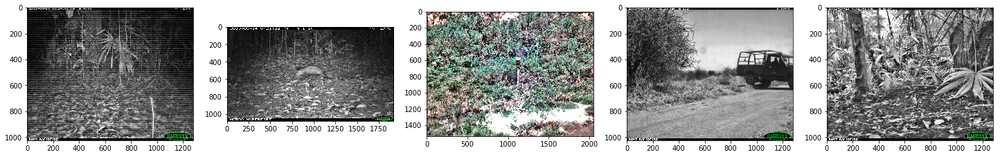

<Figure size 1800x864 with 0 Axes>

In [7]:
plt.figure(figsize=(25,12))
for idx, train_img in enumerate(train_imgs):
    if idx >= num_show:
        break
    
    temp_img = cv2.imread(train_img, cv2.IMREAD_COLOR)        
    img_lab = cv2.cvtColor(temp_img, cv2.COLOR_BGR2Lab)

    l, a, b = cv2.split(img_lab)
    img_l = clahe.apply(l)
    img_clahe = cv2.merge((img_l, a, b))

    img_clahe = cv2.cvtColor(img_clahe, cv2.COLOR_Lab2BGR)
    
    plt.subplot(10 / columns + 1, columns, idx + 1)
    plt.imshow(img_clahe)
    if idx % 5 == 4:
        plt.show()
        plt.figure(figsize=(25,12))

# Automatic White Balance
- Simple
- Grayworld
- Learning-based
Theses require xphoto in 'opencv-contrib-python'

In [8]:
wb = cv2.xphoto.createSimpleWB()
wb.setP(0.4)

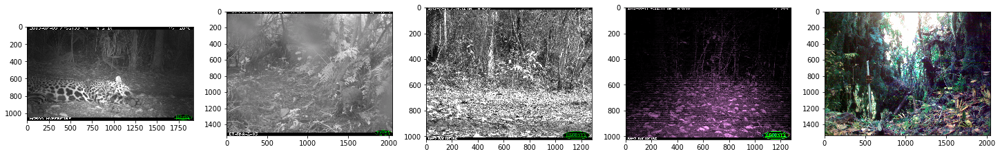

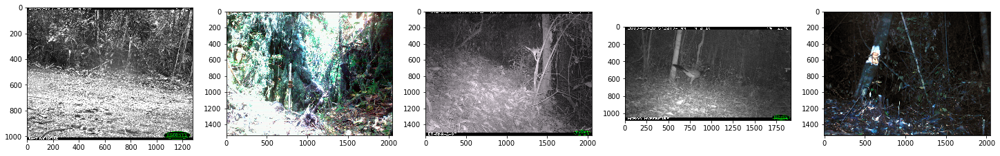

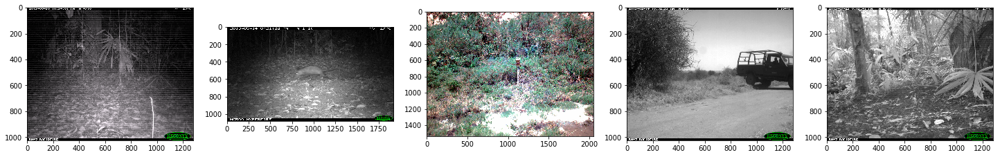

<Figure size 1800x864 with 0 Axes>

In [9]:
plt.figure(figsize=(25,12))
for idx, train_img in enumerate(train_imgs):
    if idx >= num_show:
        break
    
    temp_img = cv2.imread(train_img, cv2.IMREAD_COLOR)        
    
    img_wb = wb.balanceWhite(temp_img)
    
    plt.subplot(10 / columns + 1, columns, idx + 1)
    plt.imshow(img_wb)
    if idx % 5 == 4:
        plt.show()
        plt.figure(figsize=(25,12))

# CLAHE & Simple WB

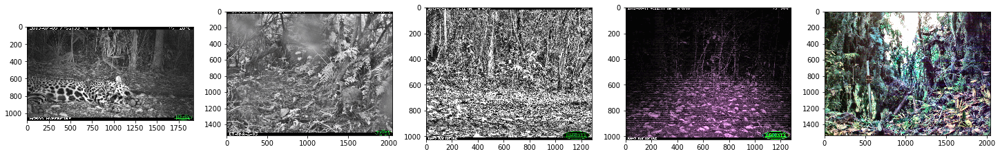

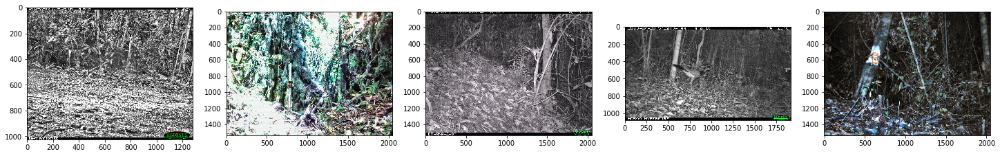

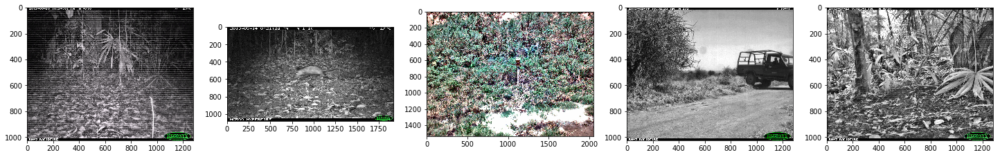

<Figure size 1800x864 with 0 Axes>

In [10]:
plt.figure(figsize=(25,12))
for idx, train_img in enumerate(train_imgs):
    if idx >= num_show:
        break
    
    temp_img = cv2.imread(train_img, cv2.IMREAD_COLOR)        
    
    img_wb = wb.balanceWhite(temp_img)

    img_lab = cv2.cvtColor(img_wb, cv2.COLOR_BGR2Lab)

    l, a, b = cv2.split(img_lab)
    res_l = clahe.apply(l)
    res = cv2.merge((res_l, a, b))

    res = cv2.cvtColor(res, cv2.COLOR_Lab2BGR)

    plt.subplot(10 / columns + 1, columns, idx + 1)
    plt.imshow(res)
    if idx % 5 == 4:
        plt.show()
        plt.figure(figsize=(25,12))

# Compare Original and Pre-processed with CLAHE & SimpleWB

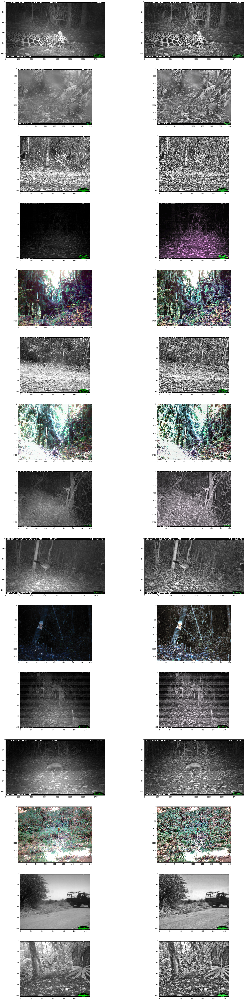

In [11]:
fig=plt.figure(figsize=(32, 128))
for idx, train_img in enumerate(train_imgs):
    if idx >= num_show:
        break
    
    temp_img = cv2.imread(train_img, cv2.IMREAD_COLOR)        
    
    img_wb = wb.balanceWhite(temp_img)

    img_lab = cv2.cvtColor(img_wb, cv2.COLOR_BGR2Lab)

    l, a, b = cv2.split(img_lab)
    res_l = clahe.apply(l)
    res = cv2.merge((res_l, a, b))

    res = cv2.cvtColor(res, cv2.COLOR_Lab2BGR)
    fig.add_subplot(15, 2, 2 * idx + 1)
    plt.imshow(temp_img)
    fig.add_subplot(15, 2, 2 * idx + 2)
    plt.imshow(res)
plt.show()